In [12]:
# Import packaages
from google.cloud import storage
import ndjson
import numpy as np
import pandas as pd

In [2]:
# List all files on the Google Bucket
! gsutil ls -r gs://quickdraw-simplified

gs://quickdraw-simplified/The Eiffel Tower.ndjson
gs://quickdraw-simplified/The Great Wall of China.ndjson
gs://quickdraw-simplified/The Mona Lisa.ndjson
gs://quickdraw-simplified/aircraft carrier.ndjson
gs://quickdraw-simplified/airplane.ndjson
gs://quickdraw-simplified/alarm clock.ndjson
gs://quickdraw-simplified/ambulance.ndjson
gs://quickdraw-simplified/angel.ndjson
gs://quickdraw-simplified/animal migration.ndjson
gs://quickdraw-simplified/ant.ndjson
gs://quickdraw-simplified/anvil.ndjson
gs://quickdraw-simplified/apple.ndjson
gs://quickdraw-simplified/arm.ndjson
gs://quickdraw-simplified/asparagus.ndjson
gs://quickdraw-simplified/axe.ndjson
gs://quickdraw-simplified/backpack.ndjson
gs://quickdraw-simplified/banana.ndjson
gs://quickdraw-simplified/bandage.ndjson
gs://quickdraw-simplified/barn.ndjson
gs://quickdraw-simplified/baseball bat.ndjson
gs://quickdraw-simplified/baseball.ndjson
gs://quickdraw-simplified/basket.ndjson
gs://quickdraw-simplified/basketball.ndjson
gs://quickdr

In [3]:
# Google Bucket name
bucket_name = 'quickdraw-simplified'

In [4]:
# Create a list of filename on the GB

def list_files(bucket_name):
    """Lists all files in the specified Google Cloud Storage bucket."""
    # Initialize a client
    storage_client = storage.Client()
    # Get the bucket
    bucket = storage_client.get_bucket(bucket_name)
    # List files in the bucket
    files = list(bucket.list_blobs())
    # Return file names
    return [file.name for file in files]

In [6]:
file_list = list_files(bucket_name)
print(file_list)

['The Eiffel Tower.ndjson', 'The Great Wall of China.ndjson', 'The Mona Lisa.ndjson', 'aircraft carrier.ndjson', 'airplane.ndjson', 'alarm clock.ndjson', 'ambulance.ndjson', 'angel.ndjson', 'animal migration.ndjson', 'ant.ndjson', 'anvil.ndjson', 'apple.ndjson', 'arm.ndjson', 'asparagus.ndjson', 'axe.ndjson', 'backpack.ndjson', 'banana.ndjson', 'bandage.ndjson', 'barn.ndjson', 'baseball bat.ndjson', 'baseball.ndjson', 'basket.ndjson', 'basketball.ndjson', 'bat.ndjson', 'bathtub.ndjson', 'beach.ndjson', 'bear.ndjson', 'beard.ndjson', 'bed.ndjson', 'bee.ndjson', 'belt.ndjson', 'bench.ndjson', 'bicycle.ndjson', 'binoculars.ndjson', 'bird.ndjson', 'birthday cake.ndjson', 'blackberry.ndjson', 'blueberry.ndjson', 'book.ndjson', 'boomerang.ndjson', 'bottlecap.ndjson', 'bowtie.ndjson', 'bracelet.ndjson', 'brain.ndjson', 'bread.ndjson', 'bridge.ndjson', 'broccoli.ndjson', 'broom.ndjson', 'bucket.ndjson', 'bulldozer.ndjson', 'bus.ndjson', 'bush.ndjson', 'butterfly.ndjson', 'cactus.ndjson', 'cake

In [23]:
# Loops through files in the file_list and downloads json data

def load_json_from_gcs(bucket_name, file_name):
    """Loads JSON data from a file in Google Cloud Storage."""
    # Initialize a client
    storage_client = storage.Client()
    # Get the bucket
    bucket = storage_client.get_bucket(bucket_name)
    # Get the blob
    blob = bucket.blob(file_name)
    # Download the file contents
    file_contents = blob.download_as_string()
    # Load JSON from the file contents
    json_data = ndjson.loads(file_contents)
    return json_data

In [24]:
data = load_json_from_gcs(bucket_name, file_list[0])

In [29]:
data_length = len(data)
print(data_length)

134801


In [32]:
data_extract = data[::100]

In [34]:
len(data_extract)

1349

In [7]:
data_fromJson = ../raw_data/jsonlist.json

../raw_data/jsonlist.json


In [8]:
# Opening JSON file
f = open('../raw_data/jsonlist.json')
 
# returns JSON object as 
# a dictionary
data = json.load(f)

In [9]:
len(data)

140098

In [10]:
data[0]

{'word': 'The Eiffel Tower',
 'countrycode': 'GB',
 'timestamp': '2017-03-11 14:47:44.05242 UTC',
 'recognized': True,
 'key_id': '5027286841556992',
 'drawing': [[[0, 22, 37, 64, 255], [218, 220, 227, 228, 211]],
  [[76, 95, 135, 141, 150, 159, 166, 180, 186, 201],
   [220, 138, 31, 0, 63, 79, 117, 150, 191, 224]],
  [[94, 104, 111, 119, 127, 141, 143, 142, 180, 191],
   [212, 167, 149, 80, 59, 41, 30, 134, 202, 232]],
  [[109, 127, 137, 147, 150, 162, 172, 185],
   [122, 120, 104, 97, 99, 124, 128, 128]],
  [[75, 130, 158], [162, 159, 150]]]}

In [13]:
##Define the function to process the Simplified file and return an array and class name (the drawing to guess)
def parse_line(sample):
    """Parse an ndjson line and return ink (as np array) and classname."""
    #sample = json.loads(ndjson_line)
    class_name = sample["word"]
    inkarray = sample["drawing"]
    stroke_lengths = [len(stroke[0]) for stroke in inkarray]
    total_points = sum(stroke_lengths)
    np_ink = np.zeros((total_points, 3), dtype=np.float32)
    current_t = 0
    for stroke in inkarray:
        for i in [0, 1]:
            np_ink[current_t:(current_t + len(stroke[0])), i] = stroke[i]
        current_t += len(stroke[0])
        np_ink[current_t - 1, 2] = 1  # stroke_end

    # Preprocessing.
    # 1. Size normalization.
    lower = np.min(np_ink[:, 0:2], axis=0)
    upper = np.max(np_ink[:, 0:2], axis=0)
    scale = upper - lower
    scale[scale == 0] = 1
    np_ink[:, 0:2] = (np_ink[:, 0:2] - lower) / scale

    # 2. Compute deltas.
    np_ink[1:, 0:2] -= np_ink[0:-1, 0:2]
    np_ink = np_ink[1:, :]
    return np_ink, class_name

In [ ]:
with open(data_simplified_path, 'r') as f:
     for i, line in enumerate(f):
        json_line = json.loads(line)
        np_ink, class_name = parse_line(json_line)
        print(np_ink)
        print(class_name)
        break

        # if i = n_row:
             # break

In [14]:
np_ink, class_name = parse_line(data[0])

In [16]:
print(np_ink)
print(class_name)

[[ 0.08627451  0.00862068  0.        ]
 [ 0.05882353  0.03017241  0.        ]
 [ 0.10588236  0.00431037  0.        ]
 [ 0.7490196  -0.07327586  1.        ]
 [-0.7019608   0.03879309  0.        ]
 [ 0.0745098  -0.35344827  0.        ]
 [ 0.15686277 -0.4612069   0.        ]
 [ 0.02352941 -0.1336207   0.        ]
 [ 0.03529412  0.27155173  0.        ]
 [ 0.03529412  0.06896552  0.        ]
 [ 0.02745098  0.16379312  0.        ]
 [ 0.05490196  0.14224136  0.        ]
 [ 0.02352941  0.17672414  0.        ]
 [ 0.05882353  0.14224136  1.        ]
 [-0.41960785 -0.05172414  0.        ]
 [ 0.03921568 -0.1939655   0.        ]
 [ 0.02745098 -0.07758623  0.        ]
 [ 0.03137255 -0.29741377  0.        ]
 [ 0.03137255 -0.09051725  0.        ]
 [ 0.05490199 -0.0775862   0.        ]
 [ 0.00784314 -0.0474138   0.        ]
 [-0.00392157  0.4482759   0.        ]
 [ 0.1490196   0.2931034   0.        ]
 [ 0.04313725  0.12931037  1.        ]
 [-0.32156864 -0.4741379   0.        ]
 [ 0.07058823 -0.00862074

array([ 0.00862068,  0.03017241,  0.00431037, -0.07327586,  0.03879309,
       -0.35344827, -0.4612069 , -0.1336207 ,  0.27155173,  0.06896552,
        0.16379312,  0.14224136,  0.17672414,  0.14224136, -0.05172414,
       -0.1939655 , -0.07758623, -0.29741377, -0.09051725, -0.0775862 ,
       -0.0474138 ,  0.4482759 ,  0.2931034 ,  0.12931037, -0.4741379 ,
       -0.00862074, -0.06896549, -0.03017241,  0.00862068,  0.10775864,
        0.01724136,  0.        ,  0.14655173, -0.01293105, -0.03879309],
      dtype=float32)

In [ ]:
# def word_processing(data_simplified_path, max_images):
#     images_dict = {}  # Initialize an empty dictionary
#     with open(data_simplified_path, 'r') as f:
#         for i, line in enumerate(f):
#             json_line = json.loads(line)
#             np_ink, class_name = parse_line(json_line)
#             length_np_ink = len(np_ink)
#             image_info = {
#                 "word": class_name,
#                 "image_nb": i,
#                 "np_ink": np_ink.tolist(),  #need to be transformed to list to dump as Json file later
#                 "length_np_ink": length_np_ink
#             }
#             images_dict[json_line["key_id"]] = image_info
#             i += 1
#             if i == max_images:
#                 break
#     return images_dict

In [21]:
data_extract_processed = []

for drawing in data : 
    np_ink, class_name = parse_line(drawing)
    tmp_dict = {'class_name':class_name, 'drawing_proc':np_ink}
    data_extract_processed.append(tmp_dict)


In [26]:
drawing_lengths = {}
for drawing in data_extract_processed:
    class_name = drawing['class_name']
    length = len(drawing['drawing_proc'])
    #strokes = sum(drawing['drawing_proc'][:,2])
    if class_name in drawing_lengths :
        drawing_lengths[class_name].append(length)
    else : 
        drawing_lengths[class_name] = [length]

In [54]:
import seaborn as sns
import matplotlib.pyplot as plt

In [47]:
np.max(drawing_lengths[list(drawing_lengths.keys())[0]])

546

<AxesSubplot:ylabel='Count'>

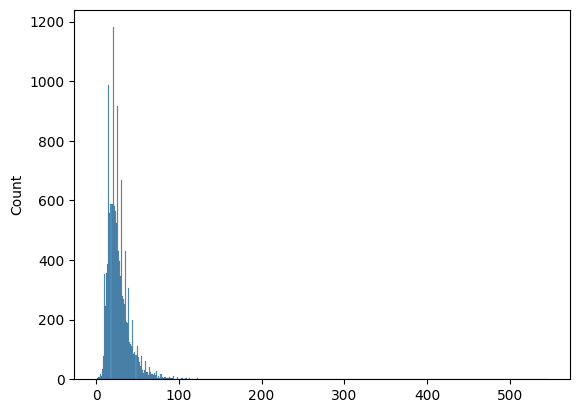

In [50]:
sns.histplot(drawing_lengths[list(drawing_lengths.keys())[0]])

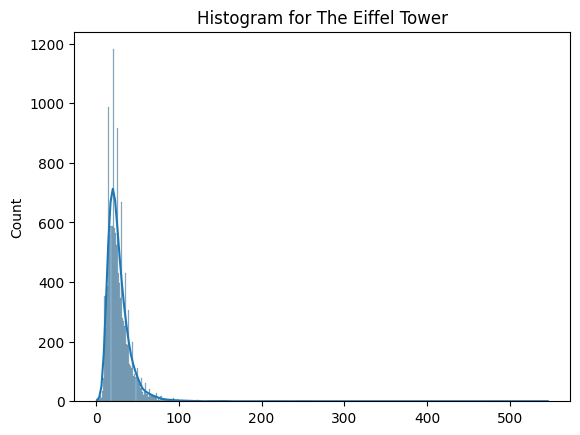

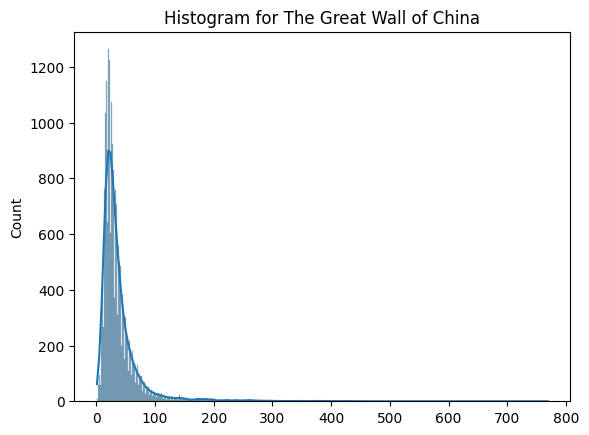

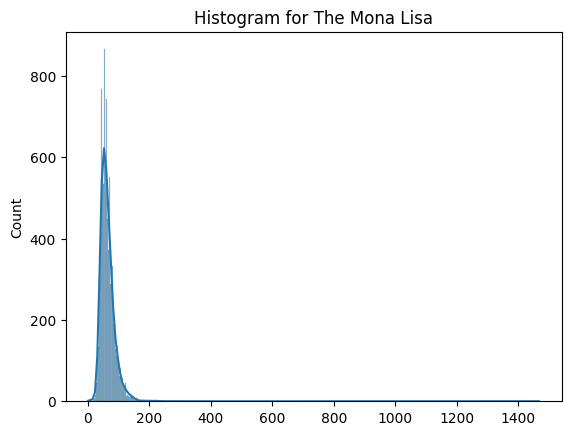

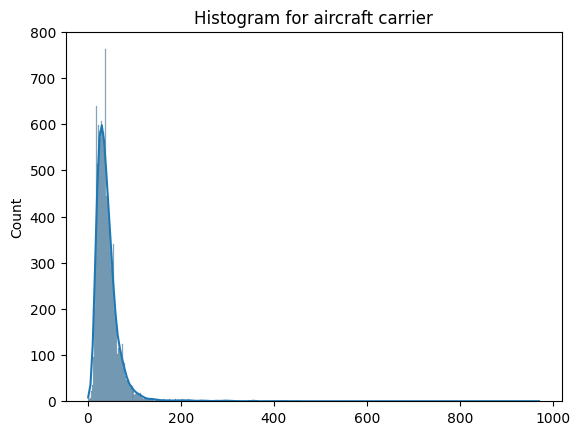

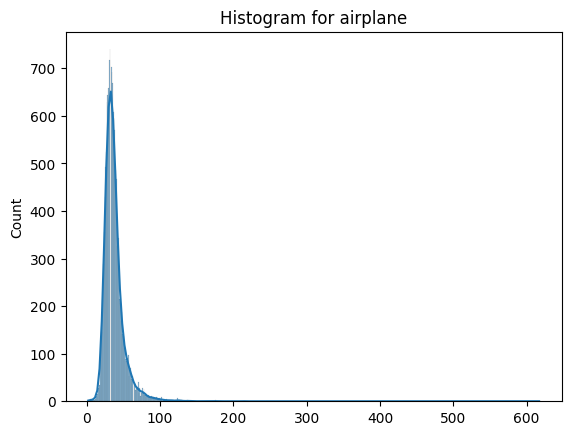

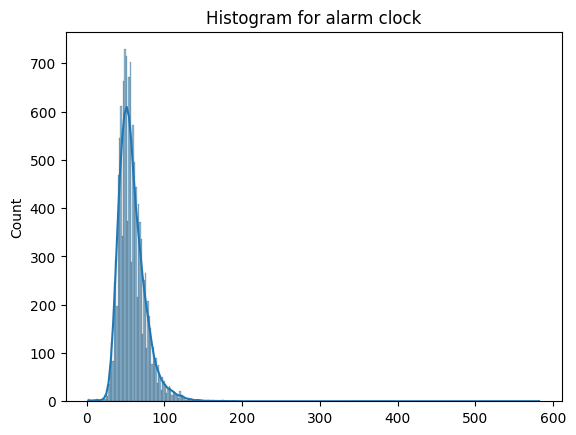

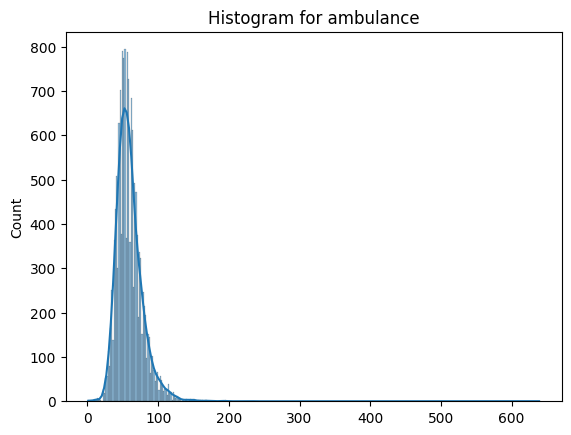

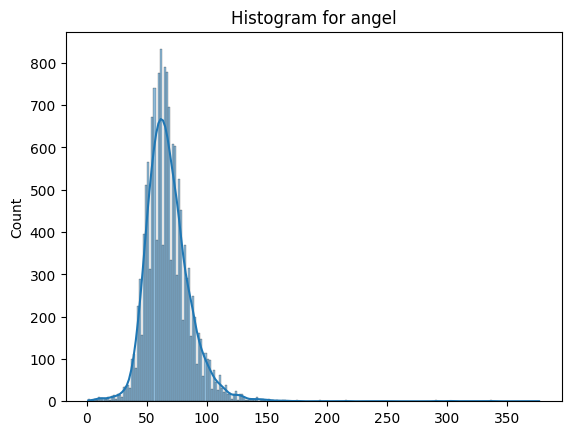

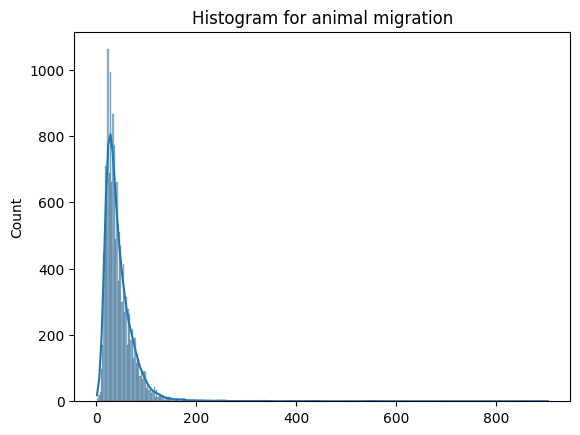

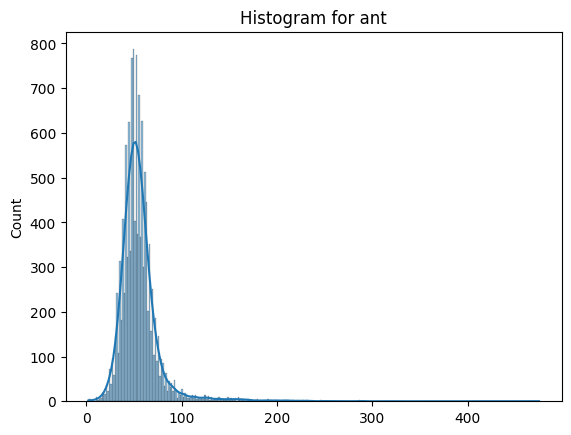

In [55]:
# Loop through the list and plot histogram for each array
for class_name in list(drawing_lengths.keys()):
    plt.figure()
    sns.histplot(drawing_lengths[class_name], kde=True)
    plt.title(f"Histogram for {class_name}")
    plt.show()

In [158]:
data_extract_processed[0]

{'class_name': 'The Eiffel Tower',
 'drawing_proc': array([[ 0.08627451,  0.00862068,  0.        ],
        [ 0.05882353,  0.03017241,  0.        ],
        [ 0.10588236,  0.00431037,  0.        ],
        [ 0.7490196 , -0.07327586,  1.        ],
        [-0.7019608 ,  0.03879309,  0.        ],
        [ 0.0745098 , -0.35344827,  0.        ],
        [ 0.15686277, -0.4612069 ,  0.        ],
        [ 0.02352941, -0.1336207 ,  0.        ],
        [ 0.03529412,  0.27155173,  0.        ],
        [ 0.03529412,  0.06896552,  0.        ],
        [ 0.02745098,  0.16379312,  0.        ],
        [ 0.05490196,  0.14224136,  0.        ],
        [ 0.02352941,  0.17672414,  0.        ],
        [ 0.05882353,  0.14224136,  1.        ],
        [-0.41960785, -0.05172414,  0.        ],
        [ 0.03921568, -0.1939655 ,  0.        ],
        [ 0.02745098, -0.07758623,  0.        ],
        [ 0.03137255, -0.29741377,  0.        ],
        [ 0.03137255, -0.09051725,  0.        ],
        [ 0.054901

In [72]:
tensor = data_extract_processed[0]['drawing_proc']
tensor

array([[ 0.08627451,  0.00862068,  0.        ],
       [ 0.05882353,  0.03017241,  0.        ],
       [ 0.10588236,  0.00431037,  0.        ],
       [ 0.7490196 , -0.07327586,  1.        ],
       [-0.7019608 ,  0.03879309,  0.        ],
       [ 0.0745098 , -0.35344827,  0.        ],
       [ 0.15686277, -0.4612069 ,  0.        ],
       [ 0.02352941, -0.1336207 ,  0.        ],
       [ 0.03529412,  0.27155173,  0.        ],
       [ 0.03529412,  0.06896552,  0.        ],
       [ 0.02745098,  0.16379312,  0.        ],
       [ 0.05490196,  0.14224136,  0.        ],
       [ 0.02352941,  0.17672414,  0.        ],
       [ 0.05882353,  0.14224136,  1.        ],
       [-0.41960785, -0.05172414,  0.        ],
       [ 0.03921568, -0.1939655 ,  0.        ],
       [ 0.02745098, -0.07758623,  0.        ],
       [ 0.03137255, -0.29741377,  0.        ],
       [ 0.03137255, -0.09051725,  0.        ],
       [ 0.05490199, -0.0775862 ,  0.        ],
       [ 0.00784314, -0.0474138 ,  0.   

In [70]:
from tensorflow.keras.preprocessing import sequence

In [71]:
padded_tensor

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0]], dtype=int32)

In [75]:
padded_tensor[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [74]:
tensor.shape

(35, 3)

In [80]:
x = [[0,0,0,0]]
y = x*4
y 

[[0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0]]

In [81]:
y + x 

[[0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0]]

In [172]:
def padded_tensor(tensor) : 
    if len(tensor) >= 150 : 
        return tensor[0:150]
    else :
        pad_length = 150 - len(tensor)
        padding = [[99,99,99]]
        return np.concatenate((tensor,np.array(padding*pad_length)),axis=0)

In [116]:
padded_tensor(tensor)

array([[ 8.62745121e-02,  8.62067938e-03,  0.00000000e+00],
       [ 5.88235334e-02,  3.01724076e-02,  0.00000000e+00],
       [ 1.05882362e-01,  4.31036949e-03,  0.00000000e+00],
       [ 7.49019623e-01, -7.32758641e-02,  1.00000000e+00],
       [-7.01960802e-01,  3.87930870e-02,  0.00000000e+00],
       [ 7.45097995e-02, -3.53448272e-01,  0.00000000e+00],
       [ 1.56862766e-01, -4.61206913e-01,  0.00000000e+00],
       [ 2.35294104e-02, -1.33620694e-01,  0.00000000e+00],
       [ 3.52941155e-02,  2.71551728e-01,  0.00000000e+00],
       [ 3.52941155e-02,  6.89655244e-02,  0.00000000e+00],
       [ 2.74509788e-02,  1.63793117e-01,  0.00000000e+00],
       [ 5.49019575e-02,  1.42241359e-01,  0.00000000e+00],
       [ 2.35294104e-02,  1.76724136e-01,  0.00000000e+00],
       [ 5.88235259e-02,  1.42241359e-01,  1.00000000e+00],
       [-4.19607848e-01, -5.17241359e-02,  0.00000000e+00],
       [ 3.92156839e-02, -1.93965495e-01,  0.00000000e+00],
       [ 2.74509788e-02, -7.75862336e-02

In [117]:
data_extract_processed[0:2]

[{'class_name': 'The Eiffel Tower',
  'drawing_proc': array([[ 0.08627451,  0.00862068,  0.        ],
         [ 0.05882353,  0.03017241,  0.        ],
         [ 0.10588236,  0.00431037,  0.        ],
         [ 0.7490196 , -0.07327586,  1.        ],
         [-0.7019608 ,  0.03879309,  0.        ],
         [ 0.0745098 , -0.35344827,  0.        ],
         [ 0.15686277, -0.4612069 ,  0.        ],
         [ 0.02352941, -0.1336207 ,  0.        ],
         [ 0.03529412,  0.27155173,  0.        ],
         [ 0.03529412,  0.06896552,  0.        ],
         [ 0.02745098,  0.16379312,  0.        ],
         [ 0.05490196,  0.14224136,  0.        ],
         [ 0.02352941,  0.17672414,  0.        ],
         [ 0.05882353,  0.14224136,  1.        ],
         [-0.41960785, -0.05172414,  0.        ],
         [ 0.03921568, -0.1939655 ,  0.        ],
         [ 0.02745098, -0.07758623,  0.        ],
         [ 0.03137255, -0.29741377,  0.        ],
         [ 0.03137255, -0.09051725,  0.        ]

In [173]:
X = []
y = []

for image in data_extract_processed : 
    padded_drawing = padded_tensor(image['drawing_proc'])
    X.append(padded_drawing)
    y.append(image['class_name'])
    print(image['class_name'])


The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tower
The Eiffel Tow

The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall o

The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall o

The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall o

The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall of China
The Great Wall o

The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mo

The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mo

The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mona Lisa
The Mo

aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carri

aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carri

aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carrier
aircraft carri

airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
a

airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
a

airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
a

airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
airplane
a

alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alar

alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alar

alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alarm clock
alar

ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance


ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance


ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance
ambulance


angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
ange

angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
ange

angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
angel
ange

animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migrati

animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migrati

animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migration
animal migrati

ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant


ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant


ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant
ant


In [133]:
np.array(X).shape

(14352, 150, 3)

In [135]:
np.array(y).shape

(14352,)

In [140]:
np.array(X).tofile('data_X.csv', sep = ',')

In [139]:
np.array(y).tofile('data_y.csv', sep = ',')

In [141]:
XX = np.genfromtxt("../raw_data/data_X.csv", delimiter=",")

In [143]:
XX.shape

(6458400,)

In [149]:
XX.reshape((14352,150,3))

array([[[ 8.62745121e-02,  8.62067938e-03,  0.00000000e+00],
        [ 5.88235334e-02,  3.01724076e-02,  0.00000000e+00],
        [ 1.05882362e-01,  4.31036949e-03,  0.00000000e+00],
        ...,
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01],
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01],
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01]],

       [[ 0.00000000e+00,  1.80392161e-01,  0.00000000e+00],
        [-1.57894790e-02,  1.96078569e-02,  0.00000000e+00],
        [ 5.26314974e-03,  5.49019575e-02,  0.00000000e+00],
        ...,
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01],
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01],
        [ 9.90000000e+01,  9.90000000e+01,  9.90000000e+01]],

       [[ 1.54639175e-02, -7.84313679e-02,  0.00000000e+00],
        [ 1.34020612e-01, -2.98039198e-01,  0.00000000e+00],
        [ 3.60824764e-02, -5.49019575e-02,  0.00000000e+00],
        ...,
        [ 9.90000000e+01,  9.90000000e+01,

In [145]:
with open("../raw_data/data_X.csv", "r") as f:
    XXX = (f.read())

'0.08627451211214066,0.008620679378509521,0.0,0.05882353335618973,0.030172407627105713,0.0,0.10588236153125763,0.0043103694915771484,0.0,0.7490196228027344,-0.0732758641242981,1.0,-0.7019608020782471,0.038793087005615234,0.0,0.07450979948043823,-0.3534482717514038,0.0,0.1568627655506134,-0.46120691299438477,0.0,0.023529410362243652,-0.13362069427967072,0.0,0.03529411554336548,0.2715517282485962,0.0,0.03529411554336548,0.06896552443504333,0.0,0.027450978755950928,0.16379311680793762,0.0,0.054901957511901855,0.14224135875701904,0.0,0.023529410362243652,0.1767241358757019,0.0,0.05882352590560913,0.14224135875701904,1.0,-0.41960784792900085,-0.051724135875701904,0.0,0.039215683937072754,-0.19396549463272095,0.0,0.027450978755950928,-0.07758623361587524,0.0,0.0313725471496582,-0.29741376638412476,0.0,0.0313725471496582,-0.09051725268363953,0.0,0.05490198731422424,-0.07758620381355286,0.0,0.00784313678741455,-0.047413796186447144,0.0,-0.003921568393707275,0.4482758939266205,0.0,0.14901959896

In [153]:
yy = np.genfromtxt("../raw_data/data_y.csv", delimiter=",",dtype='str')

In [154]:
yy

array(["'The Eiffel Tower'", "'The Eiffel Tower'", "'The Eiffel Tower'",
       ..., "'The Great Wall of China'", "'The Great Wall of China'",
       "'The Great Wall of China'"], dtype='<U25')

In [155]:
#Change for changes sake

# 7th March 2024

In [160]:
len(data_extract_processed)

{'class_name': 'The Eiffel Tower',
 'drawing_proc': array([[ 0.08627451,  0.00862068,  0.        ],
        [ 0.05882353,  0.03017241,  0.        ],
        [ 0.10588236,  0.00431037,  0.        ],
        [ 0.7490196 , -0.07327586,  1.        ],
        [-0.7019608 ,  0.03879309,  0.        ],
        [ 0.0745098 , -0.35344827,  0.        ],
        [ 0.15686277, -0.4612069 ,  0.        ],
        [ 0.02352941, -0.1336207 ,  0.        ],
        [ 0.03529412,  0.27155173,  0.        ],
        [ 0.03529412,  0.06896552,  0.        ],
        [ 0.02745098,  0.16379312,  0.        ],
        [ 0.05490196,  0.14224136,  0.        ],
        [ 0.02352941,  0.17672414,  0.        ],
        [ 0.05882353,  0.14224136,  1.        ],
        [-0.41960785, -0.05172414,  0.        ],
        [ 0.03921568, -0.1939655 ,  0.        ],
        [ 0.02745098, -0.07758623,  0.        ],
        [ 0.03137255, -0.29741377,  0.        ],
        [ 0.03137255, -0.09051725,  0.        ],
        [ 0.054901

In [171]:
count = 0
for i in range(len(data_extract_processed)) :
    if data_extract_processed[i]['drawing_proc'].shape[1] != 3 :
        count += 1
        
print(count)

0


In [178]:
np.array(X).shape

(140098, 150, 3)

In [184]:
np.array(y).shape

(140098,)

In [192]:
X_list = [data.tolist() for data in X]
X_list[0]

[[0.08627451211214066, 0.008620679378509521, 0.0],
 [0.05882353335618973, 0.030172407627105713, 0.0],
 [0.10588236153125763, 0.0043103694915771484, 0.0],
 [0.7490196228027344, -0.0732758641242981, 1.0],
 [-0.7019608020782471, 0.038793087005615234, 0.0],
 [0.07450979948043823, -0.3534482717514038, 0.0],
 [0.1568627655506134, -0.46120691299438477, 0.0],
 [0.023529410362243652, -0.13362069427967072, 0.0],
 [0.03529411554336548, 0.2715517282485962, 0.0],
 [0.03529411554336548, 0.06896552443504333, 0.0],
 [0.027450978755950928, 0.16379311680793762, 0.0],
 [0.054901957511901855, 0.14224135875701904, 0.0],
 [0.023529410362243652, 0.1767241358757019, 0.0],
 [0.05882352590560913, 0.14224135875701904, 1.0],
 [-0.41960784792900085, -0.051724135875701904, 0.0],
 [0.039215683937072754, -0.19396549463272095, 0.0],
 [0.027450978755950928, -0.07758623361587524, 0.0],
 [0.0313725471496582, -0.29741376638412476, 0.0],
 [0.0313725471496582, -0.09051725268363953, 0.0],
 [0.05490198731422424, -0.0775862038

In [199]:
import json

with open('../raw_data/X_json.json', 'w') as json_file:
        json.dump({'X_data': X_list}, json_file)
        


In [200]:
with open('../raw_data/y_json.json', 'w') as json_file:
        json.dump({'y_data': y}, json_file)

In [194]:
X_data_sample = json.dump(X_list)

TypeError: dump() missing 1 required positional argument: 'fp'

In [193]:
y

['The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel Tower',
 'The Eiffel 

In [179]:
def upload_blob(source_path, source_file_name, bucket_name, destination_blob_name=None) -> None:
    '''
    Uploads a file to the bucket.
    '''
    # Initialize a client
    storage_client = storage.Client()

    # Get the bucket
    bucket = storage_client.bucket(bucket_name)

    # Use the file name for the blob name if a blob name is not provided
    if destination_blob_name is None:
        destination_blob_name = source_file_name

    # Create a blob
    blob = bucket.blob(destination_blob_name)

    # Define the source file path
    source_file_path = '/'.join((source_path, source_file_name))

    # Upload the file to the blob
    blob.upload_from_filename(source_file_path)

In [203]:
source_path = '../raw_data/'
source_file_name = 'y_json.json'
bucket_name = 'quickdraw-simplified-modelready'

upload_blob(source_path,source_file_name,bucket_name)

In [ ]:
### FOR HONOR: 
### X_json.json ==> key: X_list ; value: X_data as list of lists
### y_json.json ==> key: y_list ; value: y as list 
### NOTE: THIS INFORMATION IS NOT SHUFFLED!
